In [1]:
import json
from owslib.wfs import WebFeatureService
import matplotlib.pyplot as plt
import geopandas as gpd
import folium

In [2]:
plt.rcParams["figure.figsize"] = (15, 15)
plt.rcParams['figure.dpi'] = 300

# Datenbezug: Amtliche Vermessung

In [3]:
geodienste_av = 'https://geodienste.ch/db/av_0'

### show available layers

In [4]:
wfs_av = WebFeatureService(url=geodienste_av,  version='2.0.0')

In [5]:
for cont in wfs_av.contents:
    print(cont + "    " +wfs_av[cont].title)

ms:PLNA    Rohrleitungsbeschriftung
ms:PLSF    Rohrleitungen (Flaechen)
ms:PLLI    Rohrleitungen (Linien)
ms:LCOBJ    BB_Nummern_Namen
ms:LCSF    Bodenbedeckung schwarzweiss
ms:LCSFC    Bodenbedeckung farbig
ms:LCSFPROJ    ProjBodenbedeckung
ms:SOOBJ    EO_Nummern_Namen
ms:SOLI    Einzelobjekte (Linien)
ms:SOSF    Einzelobjekte (Flaechen)
ms:SOSFC    Einzelobjekte farbig (Flaechen)
ms:SOPT    Einzelobjekte (Punkte)
ms:LOCPOS    Lokalisationen
ms:HADR    Gebaeudeadressen
ms:LNNA    Nomenklaturnamen
ms:OSNRPROJ    ProjLiegenschaftsnummern
ms:OSNR    Liegenschaftsnummern
ms:DPRSFPROJ    ProjSDRechte
ms:RESFPROJ    ProjLiegenschaften
ms:DPRSF    SDRechte
ms:RESF    Liegenschaften
ms:MBSF    Gemeindegrenzen
ms:TBLI    Hoheitsgrenzabschnitte
ms:OSBP    Grenzpunkte
ms:CPPT    Fixpunkte
ms:TBBP    Hoheitsgrenzpunkte


### Analyse Liegenschaften

In [6]:
layer = 'ms:RESF'
center = (2683268, 1248001)
radius = 2000

In [7]:
boun_box = (center[0] - radius / 2, center[1] - radius / 2,
            center[0] + radius / 2, center[1] + radius / 2)

feature_request = wfs_av.getfeature(typename=layer, bbox=boun_box)
Liegenschaften = gpd.read_file(feature_request)
# RuntimeWarning: Sequential read of... https://github.com/Toblerity/Fiona/issues/986

/opt/conda/lib/python3.8/site-packages/geopandas/geodataframe.py:422: RuntimeWarning: Sequential read of iterator was interrupted. Resetting iterator. This can negatively impact the performance.
  for feature in features_lst:


In [8]:
Liegenschaften

,gml_id,BFSNr,NBIdent,Nummer,EGRIS_EGRID,Vollstaendigkeit,Flaeche,Kanton,geometry
0,RESF.411585785,261,ZH0200000261,AA5497,CH585599917052,Vollstaendig,262,ZH,"POLYGON ((2683207.121 1247057.882, 2683210.408..."
1,RESF.411586695,261,ZH0200000261,AA4350,CH457099779142,Vollstaendig,372,ZH,"POLYGON ((2683035.133 1246965.512, 2683062.768..."
2,RESF.411587745,261,ZH0200000261,AA2911,CH788499917767,Vollstaendig,271,ZH,"POLYGON ((2683768.905 1247104.551, 2683768.339..."
3,RESF.411587748,261,ZH0200000261,AA2215,CH179177729908,Vollstaendig,296,ZH,"POLYGON ((2683569.008 1247095.199, 2683566.462..."
4,RESF.411587749,261,ZH0200000261,AA567,CH449199777854,Vollstaendig,219,ZH,"POLYGON ((2682518.153 1247091.259, 2682518.250..."
...,...,...,...,...,...,...,...,...,...
4409,RESF.411794053,261,ZH0200000261,AA981,CH587899917706,Vollstaendig,246,ZH,"POLYGON ((2682667.025 1247110.654, 2682668.841..."
4410,RESF.411794351,261,ZH0200000261,AA398,CH467799917834,Vollstaendig,365,ZH,"POLYGON ((2682660.448 1247105.430, 2682673.664..."
4411,RESF.411794608,261,ZH0200000261,AA1826,CH219170997776,Vollstaendig,6738,ZH,"POLYGON ((2682847.425 1247054.339, 2682863.713..."
4412,RESF.411795320,261,ZH0200000261,HO3992,CH350299799163,Vollstaendig,239,ZH,"POLYGON ((2684220.808 1247107.731, 2684220.656..."


(2681053.5143500003, 2684812.2946500005, 1246635.97435, 1249944.04065)

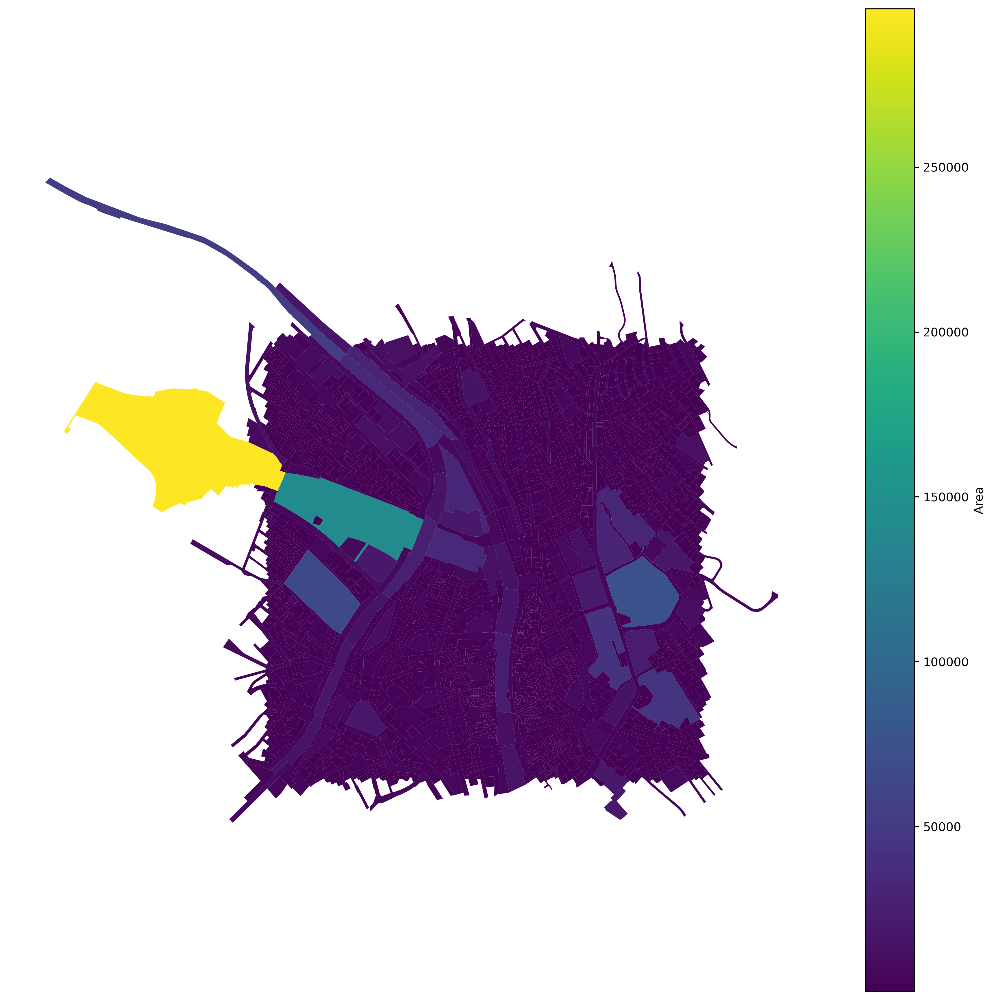

In [9]:
Liegenschaften.plot(column='Flaeche', legend=True,legend_kwds={'label': "Area",'orientation': "vertical"})
plt.axis('off')

## map with click-to-see-properties

In [10]:
data_geojson = Liegenschaften.to_crs(epsg='4326').to_json()
js_data = json.loads(data_geojson)
m = folium.Map(tiles='CartoDB positron')
for feature in js_data['features']:
    b = folium.GeoJson(feature['geometry'])
    pop_sting = '<small>'
    for prop in feature['properties']:
        pop_sting += prop + ': ' + str(feature['properties'][prop]) + '<br>'    
    b.add_child(folium.Popup(pop_sting))
    b.add_to(m)
m.fit_bounds(folium.features.GeoJson(data_geojson).get_bounds())
m

![map_pic](https://github.com/Brieden/trash/raw/main/Liegenschaften_with_properties.png)

### Analyse Bodenbedeckung farbig

In [11]:
layer = 'ms:LCSFC'
center = (2683268, 1248001)
radius = 800

In [12]:
boun_box = (center[0] - radius / 2, center[1] - radius / 2,
            center[0] + radius / 2, center[1] + radius / 2)

feature_request = wfs_av.getfeature(typename=layer, bbox=boun_box)
Bodenbedeckung = gpd.read_file(feature_request)
# RuntimeWarning: Sequential read of... https://github.com/Toblerity/Fiona/issues/986

/opt/conda/lib/python3.8/site-packages/geopandas/geodataframe.py:422: RuntimeWarning: Sequential read of iterator was interrupted. Resetting iterator. This can negatively impact the performance.
  for feature in features_lst:


In [13]:
Bodenbedeckung

,gml_id,BFSNr,Qualitaet,Art,GWR_EGID,Kanton,geometry
0,LCSFC.835739649,261,AV93,befestigt.Bahn,None,ZH,"POLYGON ((2682375.956 1248442.247, 2682394.314..."
1,LCSFC.835719051,261,AV93,Gebaeude,2372851,ZH,"POLYGON ((2682970.525 1247907.818, 2682962.434..."
2,LCSFC.835721235,261,AV93,Gebaeude,2370759,ZH,"POLYGON ((2683498.931 1248382.510, 2683493.787..."
3,LCSFC.835722329,261,AV93,Gebaeude,153709,ZH,"POLYGON ((2683572.297 1248360.294, 2683572.750..."
4,LCSFC.835722797,261,AV93,Gebaeude,140556,ZH,"POLYGON ((2683615.889 1248009.868, 2683609.627..."
...,...,...,...,...,...,...,...
1274,LCSFC.835720240,261,AV93,Gebaeude,140663,ZH,"POLYGON ((2683174.569 1247634.441, 2683174.281..."
1275,LCSFC.835720598,261,AV93,befestigt.Verkehrsinsel,None,ZH,"POLYGON ((2683080.506 1247662.024, 2683084.463..."
1276,LCSFC.835720624,261,AV93,befestigt.Strasse_Weg,None,ZH,"POLYGON ((2683262.093 1247635.559, 2683264.399..."
1277,LCSFC.835720954,261,AV93,befestigt.Trottoir,None,ZH,"POLYGON ((2683198.556 1247609.377, 2683198.263..."


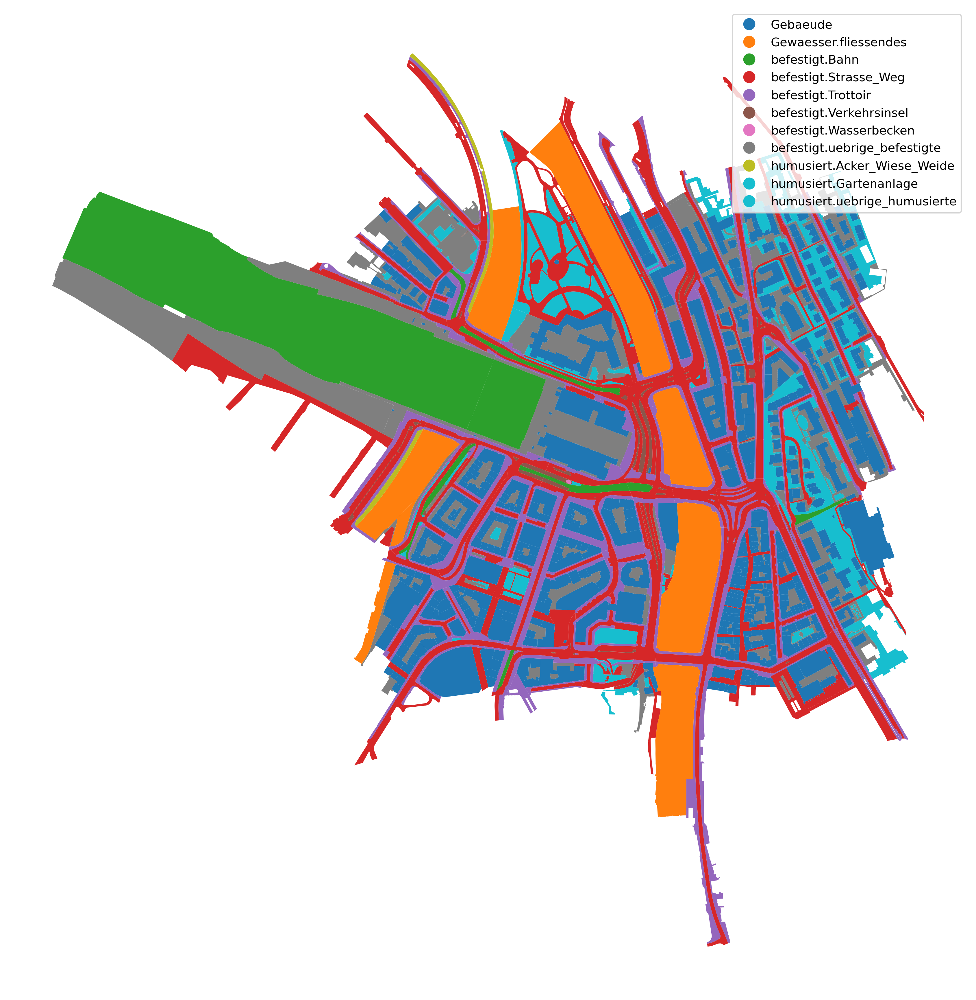

In [14]:
Bodenbedeckung.plot(column='Art', legend=True)
plt.axis('off');

# Datenbezug: Nutzungsplanung (kantonal / kommunal)

In [15]:
geodienste_nutzung = 'https://geodienste.ch/db/npl_nutzungsplanung_0'

### show available layers

In [16]:
wfs_n = WebFeatureService(url=geodienste_nutzung,  version='2.0.0')

In [17]:
for cont in wfs_n.contents:
    print(cont + "    " +wfs_n[cont].title)

ms:grundnutzung    Grundnutzung
ms:ueberlagernde_nutzungsplaninhalte_flaechen    Überlagernde Nutzungsplaninhalte (flächenbezogene Festlegungen)
ms:ueberlagernde_nutzungsplaninhalte_linien    Überlagernde Nutzungsplaninhalte (linienbezogene Festlegungen)
ms:ueberlagernde_nutzungsplaninhalte_punkte    Überlagernde Nutzungsplaninhalte (punktbezogene Festlegungen)


### Analyse Liegenschaften

In [18]:
layer = 'ms:grundnutzung'
center = (2611727, 1265953)
radius = 3000

In [19]:
boun_box = (center[0] - radius / 2, center[1] - radius / 2,
            center[0] + radius / 2, center[1] + radius / 2)

feature_request = wfs_n.getfeature( typename=layer, bbox=boun_box)
nutzung = gpd.read_file(feature_request)
# RuntimeWarning: Sequential read of... https://github.com/Toblerity/Fiona/issues/986

/opt/conda/lib/python3.8/site-packages/geopandas/geodataframe.py:422: RuntimeWarning: Sequential read of iterator was interrupted. Resetting iterator. This can negatively impact the performance.
  for feature in features_lst:


In [20]:
nutzung

,gml_id,t_id,publiziertab,rechtsstatus,bemerkungen,typ_kommunal_code,typ_kommunal_bezeichnung,typ_kantonal_code,typ_kantonal_bezeichnung,hauptnutzung_code,hauptnutzung_bezeichnung,kanton,geometry
0,grundnutzung.10664660,10664660,2014-01-15,inKraft,None,GA_iS_B,Grünanlagenzone im Siedlungsgebiet,GA_iS_K,Grünanlagenzone im Siedlungsgebiet,16,eingeschränkte Bauzonen,BS,"POLYGON ((2611224.771 1267196.881, 2611229.022..."
1,grundnutzung.10665155,10665155,2014-01-15,inKraft,None,GA_iS_B,Grünanlagenzone im Siedlungsgebiet,GA_iS_K,Grünanlagenzone im Siedlungsgebiet,16,eingeschränkte Bauzonen,BS,"POLYGON ((2612345.140 1266982.058, 2612345.213..."
2,grundnutzung.10665203,10665203,2014-01-15,inKraft,None,GA_iS_B,Grünanlagenzone im Siedlungsgebiet,GA_iS_K,Grünanlagenzone im Siedlungsgebiet,16,eingeschränkte Bauzonen,BS,"POLYGON ((2611465.430 1266471.517, 2611465.486..."
3,grundnutzung.10666081,10666081,2014-01-15,inKraft,None,3_kAG_B,Zone 3 ohne Arbeitsgeschoss,Wohnzone,Wohnzone Basel,11,Wohnzonen,BS,"POLYGON ((2612478.698 1264705.600, 2612486.583..."
4,grundnutzung.10664844,10664844,2014-01-15,inKraft,None,4_AG_B,Zone 4 mit Arbeitsgeschoss,Mischzone,Mischzone Basel,13,Mischzonen,BS,"POLYGON ((2610781.712 1266610.382, 2610773.247..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1340,grundnutzung.12373153,12373153,2021-01-07,inKraft,None,180102,Strasse innerhalb ZPS,1801,Strasse innerhalb ZPS,18,Verkehrszonen innerhalb der Bauzonen,BL,"POLYGON ((2610515.115 1265428.287, 2610506.370..."
1341,grundnutzung.12373154,12373154,2021-01-07,inKraft,None,112033,Zone für öffentliche Werke und Anlagen OeWA,1120,OeWA mit Zweckbestimmung,15,Zonen für öffentliche Nutzungen,BL,"POLYGON ((2611144.137 1265628.083, 2611132.170..."
1342,grundnutzung.12374778,12374778,2020-05-14,inKraft,None,103401,"Wohn- und Geschäftszone, 4-geschossig, mässig ...",1034,WG4-E,13,Mischzonen,BL,"POLYGON ((2613081.303 1264561.736, 2613084.721..."
1343,grundnutzung.12374825,12374825,2020-05-14,inKraft,None,103401,"Wohn- und Geschäftszone, 4-geschossig, mässig ...",1034,WG4-E,13,Mischzonen,BL,"POLYGON ((2613113.661 1264435.738, 2613117.519..."


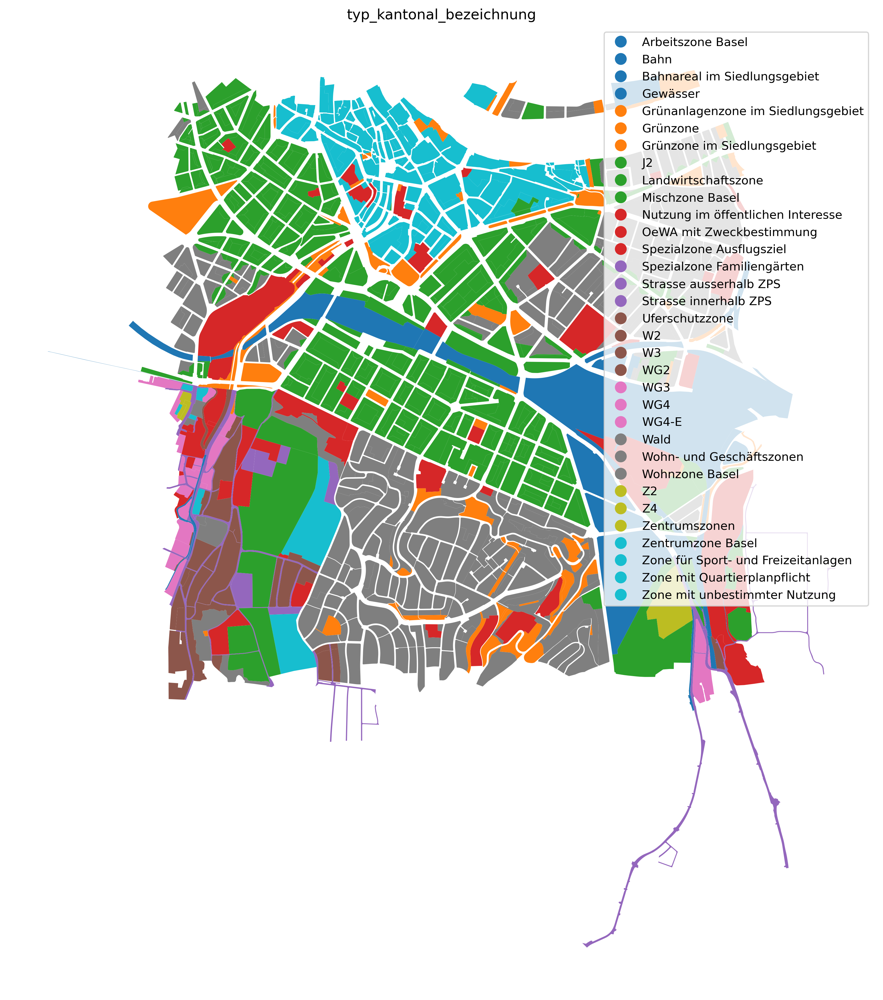

In [21]:
nutzung.plot(column='typ_kantonal_bezeichnung',legend=True)
plt.axis('off'), plt.title('typ_kantonal_bezeichnung');

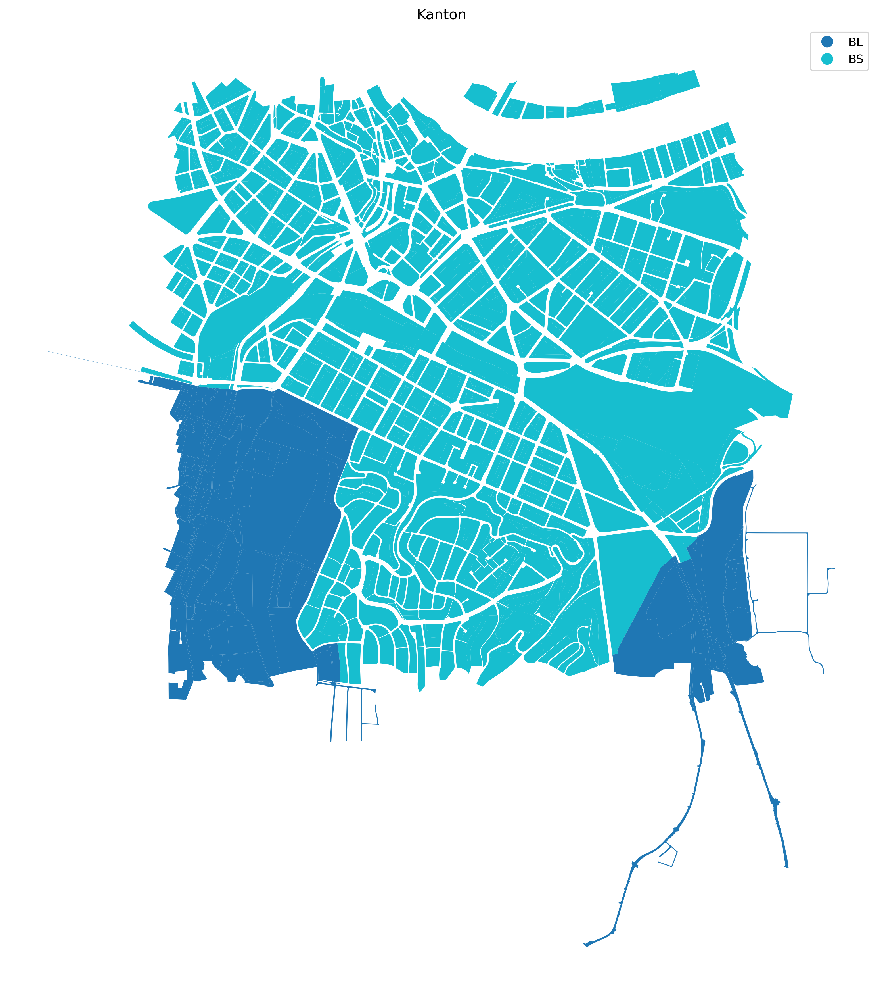

In [22]:
nutzung.plot(column='kanton',legend=True)
plt.title('Kanton'), plt.axis('off');